In [12]:
!wget https://geekreply.com/wp-content/uploads/2018/01/Humminbird-1000x600.jpg -O hummingbird.jpg

--2020-07-09 11:45:46--  https://geekreply.com/wp-content/uploads/2018/01/Humminbird-1000x600.jpg
Resolving geekreply.com (geekreply.com)... 172.81.117.222
Connecting to geekreply.com (geekreply.com)|172.81.117.222|:443... connected.
HTTP request sent, awaiting response... 200 OK
Length: 55329 (54K) [image/jpeg]
Saving to: ‘hummingbird.jpg’

hummingbird.jpg     100%[===================>]  54.03K   124KB/s    in 0.4s    

2020-07-09 11:45:48 (124 KB/s) - ‘hummingbird.jpg’ saved [55329/55329]



In [1]:
from tensorflow.keras.applications import ResNet50
from tensorflow.keras.applications.resnet import preprocess_input
from tensorflow.keras.preprocessing.image import img_to_array
from tensorflow.keras.applications import imagenet_utils
from imutils.object_detection import non_max_suppression
import numpy as np
import argparse
import imutils
import time
import cv2

In [2]:
# 한번 호출될 때 마다 step 위치만큼 우측으로 이동, 그리고 아래로 이동하여 ws(window size) 크기의 이미지를 반환
def sliding_window(image, step, ws):
	# slide a window across the image
	for y in range(0, image.shape[0] - ws[1], step):
		for x in range(0, image.shape[1] - ws[0], step):
			# yield the current window
			yield (x, y, image[y:y + ws[1], x:x + ws[0]])

# 한번 호출될 때 마다 scale만큼 줄어든 이미지를 반환한다. 최소 크기 minSize 될때 까지
def image_pyramid(image, scale=1.5, minSize=(224, 224)):
	# yield the original image
	yield image

	# keep looping over the image pyramid
	while True:
		# compute the dimensions of the next image in the pyramid
		w = int(image.shape[1] / scale)
		image = imutils.resize(image, width=w)

		# if the resized image does not meet the supplied minimum
		# size, then stop constructing the pyramid
		if image.shape[0] < minSize[1] or image.shape[1] < minSize[0]:
			break

		# yield the next image in the pyramid
		yield image

# 실행될 파라매터 값 선언

In [3]:
# construct the argument parse and parse the arguments
# ap = argparse.ArgumentParser()
# ap.add_argument("-i", "--image", required=True,
# 	help="path to the input image")
# ap.add_argument("-s", "--size", type=str, default="(200, 150)",
# 	help="ROI size (in pixels)")
# ap.add_argument("-c", "--min-conf", type=float, default=0.9,
# 	help="minimum probability to filter weak detections")
# ap.add_argument("-v", "--visualize", type=int, default=-1,
# 	help="whether or not to show extra visualizations for debugging")

args = {}
args["size"] = "(200, 150)"

# [주의!]
# Colab 사용할 때는 먼저 이미지 파일을 업로드 해 두세요.
#
args["image"] = "hummingbird.jpg"
args["visualize"] = 1
args["min_conf"] = 0.9

# 상수 선언

In [4]:
# initialize variables used for the object detection procedure
WIDTH = 600
PYR_SCALE = 1.5
WIN_STEP = 16
ROI_SIZE = eval(args["size"])
INPUT_SIZE = (224, 224)

# 사용할 CNN classifier 로딩

In [5]:
print("[INFO] loading network...")
model = ResNet50(weights="imagenet", include_top=True)

[INFO] loading network...
102973440/102967424 [==============================] - 1s 0us/step


# 이미지 로딩

In [14]:
# load the input image from disk, resize it such that it has the
# has the supplied width, and then grab its dimensions
orig = cv2.imread(args["image"])
orig = imutils.resize(orig, width=WIDTH)
(H, W) = orig.shape[:2]

# 대상 부분 이미지 준비

rois와 locs를 준비한다.
- rois : 관심 대상(region of interest)의 이미지 리스트
- locs : 관심 대상의 좌표 4개값의 리스트


In [15]:
# initialize two lists, one to hold the ROIs generated from the image
# pyramid and sliding window, and another list used to store the
# (x, y)-coordinates of where the ROI was in the original image
rois = []  # 관심 대상(region of interest)의 이미지 리스트
locs = []  # 관심 대상의 좌표 4개값의 리스트

In [16]:
# time how long it takes to loop over the image pyramid layers and
# sliding window locations
start = time.time()

In [17]:
from matplotlib import pyplot as plt

# rois, locs 구하기

pyramid(다양한 스케일의 영역)에 대하여 루프를 돌고,

윈도우 슬라이딩(위치를 변경하며)에 대한 루프를 돌면서

관심 영역(ROI)의 이미지를 구하여 rois에 넣고, 좌표를 locs에 넣는다.

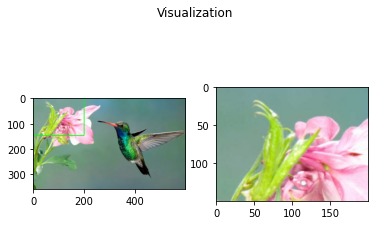

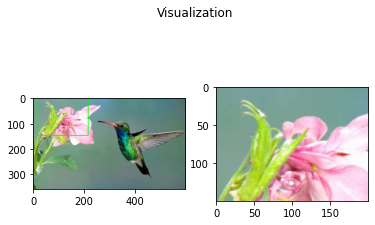

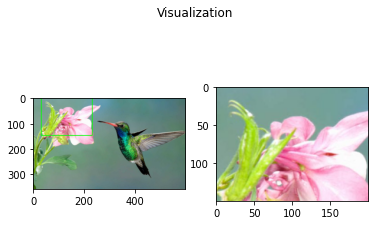

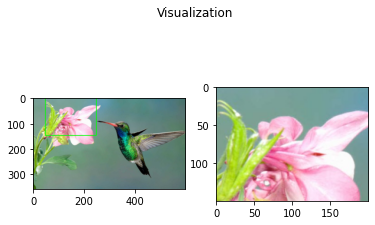

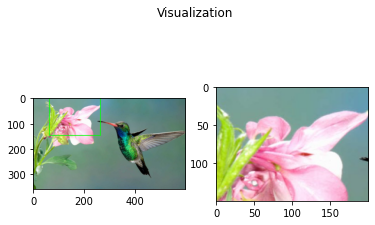

...

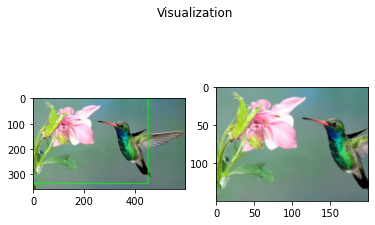

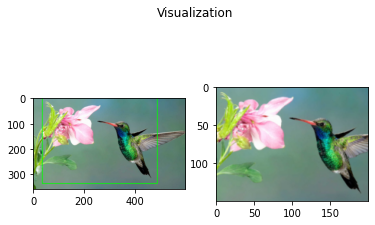

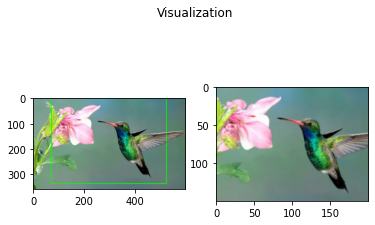

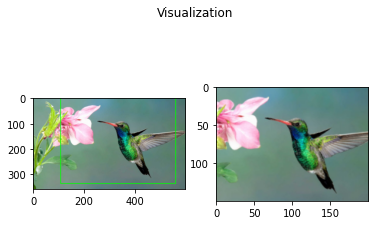

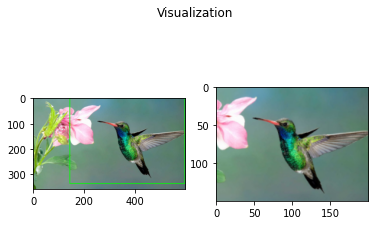

In [18]:
for image in image_pyramid(orig, scale=PYR_SCALE, minSize=ROI_SIZE):
  # determine the scale factor between the *original* image
  # dimensions and the *current* layer of the pyramid
  scale = W / float(image.shape[1])

  # for each layer of the image pyramid, loop over the sliding
  # window locations
  for (x, y, roiOrig) in sliding_window(image, WIN_STEP, ROI_SIZE):
    # scale the (x, y)-coordinates of the ROI with respect to the
    # *original* image dimensions
    x = int(x * scale)
    y = int(y * scale)
    w = int(ROI_SIZE[0] * scale)
    h = int(ROI_SIZE[1] * scale)

    # take the ROI and pre-process it so we can later classify
    # the region using Keras/TensorFlow
    roi = cv2.resize(roiOrig, INPUT_SIZE)
    roi = img_to_array(roi)
    roi = preprocess_input(roi)

    # update our list of ROIs and associated coordinates
    rois.append(roi)
    locs.append((x, y, x + w, y + h))

    # check to see if we are visualizing each of the sliding
    # windows in the image pyramid
    if 1 > 0:
      # clone the original image and then draw a bounding box
      # surrounding the current region
      clone = orig.copy()
      cv2.rectangle(clone, (x, y), (x + w, y + h), (0, 255, 0), 2)

      clone2 = clone[:,:,::-1]
      roiOrig2 = roiOrig[:,:,::-1]

      fig, (ax1, ax2) = plt.subplots(1, 2)
      fig.suptitle('Visualization')
      ax1.imshow(clone2)
      ax2.imshow(roiOrig2)
      plt.show()

      # show the visualization and current ROI
      # cv2.imshow("Visualization", clone)
      # cv2.imshow("ROI", roiOrig)
      # cv2.waitKey(0)

In [19]:
# show how long it took to loop over the image pyramid layers and
# sliding window locations
end = time.time()
print("[INFO] looping over pyramid/windows took {:.5f} seconds".format(end - start))

[INFO] looping over pyramid/windows took 104.69194 seconds


In [20]:
# convert the ROIs to a NumPy array
rois = np.array(rois, dtype="float32")

# 각 이미지별 분류

rois에 담긴 부분 이미지들에 대한 분류 예측한 값들이 preds에 담긴다.

In [21]:
# classify each of the proposal ROIs using ResNet and then show how
# long the classifications took
print("[INFO] classifying ROIs...")
start = time.time()
preds = model.predict(rois)
end = time.time()
print("[INFO] classifying ROIs took {:.5f} seconds".format(
	end - start))

[INFO] classifying ROIs...
[INFO] classifying ROIs took 10.19208 seconds


# 출력된 값을 파싱

In [22]:
# decode the predictions and initialize a dictionary which maps class
# labels (keys) to any ROIs associated with that label (values)
preds = imagenet_utils.decode_predictions(preds, top=1)
labels = {}

40960/35363 [==================================] - 0s 0us/step


# 레이블링 구하기

예측된 값에 해당하는 레이블링 값들을 구한다.

In [23]:
# loop over the predictions
for (i, p) in enumerate(preds):
	# grab the prediction information for the current ROI
	(imagenetID, label, prob) = p[0]

	# filter out weak detections by ensuring the predicted probability
	# is greater than the minimum probability
	if prob >= args["min_conf"]:
		# grab the bounding box associated with the prediction and
		# convert the coordinates
		box = locs[i]

		# grab the list of predictions for the label and add the
		# bounding box and probability to the list
		L = labels.get(label, [])
		L.append((box, prob))
		labels[label] = L

# 각 레이블별 대표 box 구하기

Non-Maxia Supression 알고리즘을 사용하여 동일 객체에 대한 box들을 제거한다.

[INFO] showing results for 'hummingbird'


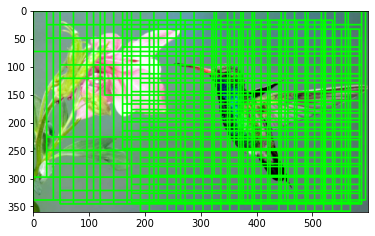

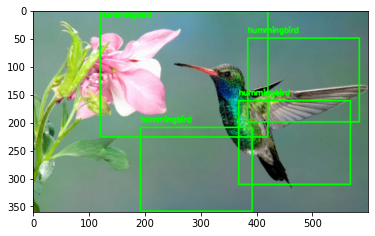

[INFO] showing results for 'jacamar'


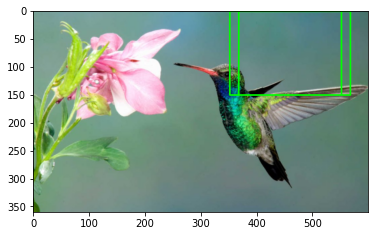

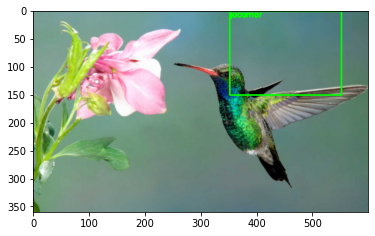

In [24]:
# loop over the labels for each of detected objects in the image
for label in labels.keys():
  # clone the original image so that we can draw on it
  print("[INFO] showing results for '{}'".format(label))
  clone = orig.copy()

  # loop over all bounding boxes for the current label
  for (box, prob) in labels[label]:
    # draw the bounding box on the image
    (startX, startY, endX, endY) = box
    cv2.rectangle(clone, (startX, startY), (endX, endY), (0, 255, 0), 2)

  # show the results *before* applying non-maxima suppression, then
  # clone the image again so we can display the results *after*
  # applying non-maxima suppression
  # cv2.imshow("Before", clone)

  clone2 = clone[:,:,::-1]
  plt.imshow(clone2)
  plt.show()

  clone = orig.copy()

  # extract the bounding boxes and associated prediction
  # probabilities, then apply non-maxima suppression
  boxes = np.array([p[0] for p in labels[label]])
  proba = np.array([p[1] for p in labels[label]])
  boxes = non_max_suppression(boxes, proba)

  # loop over all bounding boxes that were kept after applying
  # non-maxima suppression
  for (startX, startY, endX, endY) in boxes:
    # draw the bounding box and label on the image
    cv2.rectangle(clone, (startX, startY), (endX, endY), (0, 255, 0), 2)
    y = startY - 10 if startY - 10 > 10 else startY + 10
    cv2.putText(clone, label, (startX, y), cv2.FONT_HERSHEY_SIMPLEX, 0.45, (0, 255, 0), 2)

  # show the output after apply non-maxima suppression
  # cv2.imshow("After", clone)
  # cv2.waitKey(0)
  clone2 = clone[:,:,::-1]
  plt.imshow(clone2)
  plt.show()